# Business Case

O Paper CO é um importante player que produz principalmente celulose fornecendo este importante material para as papeleiras e para suas próprias máquinas de papel. O mercado está cada vez mais desafiador devido à queda dos preços internacionais da celulose
Diante do cenário desafiador, a Paper Co está iniciando um projeto de redução de custos com manutenção evitando a superação de alguns ativos específicos e mantendo a mesma disponibilidade de todo o processo. Para isso, será necessário prever falhas nos ativos selecionados.
O chefe de operações perguntou se é possível prever tais eventos e com base em suas respostas ele mudará os planos de manutenção.

# 0.0. Imports

In [1]:
import pickle
import math
import warnings
import numpy   as np
import pandas  as pd
import seaborn as sns
import xgboost as xgb

from scipy                   import stats as ss
from matplotlib              import pyplot as plt
from boruta                  import BorutaPy
from IPython.display         import Image
from sklearn.metrics         import mean_absolute_error, mean_squared_error, confusion_matrix, accuracy_score, roc_auc_score, precision_score, recall_score, f1_score, classification_report
from sklearn.ensemble        import RandomForestRegressor, RandomForestClassifier
from IPython.core.display    import HTML
from sklearn.preprocessing   import RobustScaler, MinMaxScaler, StandardScaler
from sklearn.model_selection import train_test_split, KFold
from sklearn.linear_model    import LinearRegression, Lasso


warnings.filterwarnings('ignore')

## 0.1. Funções

In [2]:
# Função para calculo da porcentagem da raiz do erro médio
def root_mean_square_percentage_error(y, yhat):
    rmspe = np.sqrt(np.mean(np.square(((y - yhat)/y)), axis=0))
    return rmspe

# Função para calculo da porcentagem do erro médio
def mean_percentage_error(y, yhat):
    return np.mean((y - yhat)/y) 

# Função que retorna todos os erros calculados
def ml_error(nome_model, y, yhat):
    mae = mean_absolute_error(y, yhat)
    rmse = np.sqrt(mean_squared_error(y, yhat))
    
    return pd.DataFrame({'Nome modelo': nome_model,
                         'MAE': mae,
                         'RMSE': rmse}, index=[0])

# Função para validação cruzada da regressão
def validacao_cruzada_reg(df, features, target, kfold, nome_model, model, verbose=False):
    # Numero de kfolds
    kf = KFold(n_splits=kfold,  random_state=42)
    
    # Inicio das variaveis listas para armazenar os valores das métricas
    mae_list = []
    rmse_list = []
    r2_list = []
    x = 1
    
    # Loop de iteração para rodar cada KFOLD
    for train_index, test_index in kf.split(df):
        
        # Print do KFOLD em execução
        if verbose:
            print('\nKFold numero: {}'.format(x))
        
        # Definindo dados treino e teste
        X_treino, X_val = df.loc[train_index,features], df.loc[test_index,features]
        y_treino, y_val = df.loc[train_index,target], df.loc[test_index,target]

        # Modelo
        m = model.fit(X_treino, y_treino)
        
        # Armazenando acucaria
        r2_list.append(m.score(X_val, y_val))
        
        # Predição
        yhat = m.predict(X_val)
        
        # Voltando os dados ao normal
        yhat = np.expm1(yhat)
        yhat = scaler_y_reg.inverse_transform(yhat.reshape(-1,1))       
        y_val = np.expm1(y_val)
        y_val = scaler_y_reg.inverse_transform(y_val)

        # Performance 
        m_result = ml_error(nome_model, y_val, yhat)
        
        # Armazenando a performance para cada iteração KFOLD
        mae_list.append(m_result['MAE'])
        rmse_list.append(m_result['RMSE'])
        
        x=x+1
    # Retorna um dataframe com a média e desvio padrão das 5 iterações do KFOLD
    return pd.DataFrame({'Nome modelo': nome_model,
                         'MAE CV': np.round(np.mean(mae_list), 2).astype(str) + ' +/- ' + np.round(np.std(mae_list), 2).astype(str),
                         'RMSE CV': np.round(np.mean(rmse_list), 2).astype(str) + ' +/- ' + np.round(np.std(rmse_list), 2).astype(str),
                         'R2 CV': np.round(np.mean(r2_list), 2).astype(str) + ' +/- ' + np.round(np.std(r2_list), 2).astype(str)}, index = [0])


# Função para validação cruzada da classificação
def validacao_cruzada_cla(df, features, target, kfold, nome_model, model, verbose=False):
    # Numero de kfolds
    kf = KFold(n_splits=kfold,  random_state=42)
    
    # Inicio das variaveis listas para armazenar os valores das métricas
    # Classificação
    accuracy_list = []
    roc_list = []
    precision_list = []
    recall_list = []
    f1_list = []
    
    x = 1
    
    # Loop de iteração para rodar cada KFOLD
    for train_index, test_index in kf.split(df):
        
        # Print do KFOLD em execução
        if verbose:
            print('\nKFold numero: {}'.format(x))
        
        # Definindo dados treino e teste
        X_treino, X_val = df.loc[train_index,features], df.loc[test_index,features]
        y_treino, y_val = df.loc[train_index,target], df.loc[test_index,target]

        # Modelo
        m = model.fit(X_treino, y_treino)
        
        # Predição
        yhat = m.predict(X_val)
        
        # Armazenando a performance para cada iteração KFOLD
        accuracy_list.append(accuracy_score(y_val, yhat))
        roc_list.append(roc_auc_score(y_val, yhat))
        precision_list.append(precision_score(y_val, yhat))
        recall_list.append(recall_score(y_val, yhat))
        f1_list.append(f1_score(y_val, yhat))
        
        x=x+1
    # Retorna um dataframe com a média e desvio padrão das 5 iterações do KFOLD
    return pd.DataFrame({'Nome modelo': nome_model,
                         'Acuracia': np.round(np.mean(accuracy_list), 2).astype(str) + ' +/- ' + np.round(np.std(accuracy_list), 2).astype(str),
                         'Roc': np.round(np.mean(roc_list), 2).astype(str) + ' +/- ' + np.round(np.std(roc_list), 2).astype(str),
                         'Precisao': np.round(np.mean(precision_list), 2).astype(str) + ' +/- ' + np.round(np.std(precision_list), 2).astype(str),
                         'Recall': np.round(np.mean(recall_list), 2).astype(str) + ' +/- ' + np.round(np.std(recall_list), 2).astype(str),
                         'F1': np.round(np.mean(f1_list), 2).astype(str) + ' +/- ' + np.round(np.std(f1_list), 2).astype(str)}, index = [0])



# Função para plotar matrix de confusão bonita
def make_confusion_matrix(cf,
                          group_names=None,
                          categories='auto',
                          count=True,
                          percent=True,
                          cbar=True,
                          xyticks=True,
                          xyplotlabels=True,
                          sum_stats=True,
                          figsize=None,
                          cmap='Blues',
                          title=None):
    '''
    This function will make a pretty plot of an sklearn Confusion Matrix cm using a Seaborn heatmap visualization.
    Arguments
    ---------
    cf:            confusion matrix to be passed in
    group_names:   List of strings that represent the labels row by row to be shown in each square.
    categories:    List of strings containing the categories to be displayed on the x,y axis. Default is 'auto'
    count:         If True, show the raw number in the confusion matrix. Default is True.
    normalize:     If True, show the proportions for each category. Default is True.
    cbar:          If True, show the color bar. The cbar values are based off the values in the confusion matrix.
                   Default is True.
    xyticks:       If True, show x and y ticks. Default is True.
    xyplotlabels:  If True, show 'True Label' and 'Predicted Label' on the figure. Default is True.
    sum_stats:     If True, display summary statistics below the figure. Default is True.
    figsize:       Tuple representing the figure size. Default will be the matplotlib rcParams value.
    cmap:          Colormap of the values displayed from matplotlib.pyplot.cm. Default is 'Blues'
                   See http://matplotlib.org/examples/color/colormaps_reference.html
                   
    title:         Title for the heatmap. Default is None.
    '''


    # CODE TO GENERATE TEXT INSIDE EACH SQUARE
    blanks = ['' for i in range(cf.size)]

    if group_names and len(group_names)==cf.size:
        group_labels = ["{}\n".format(value) for value in group_names]
    else:
        group_labels = blanks

    if count:
        group_counts = ["{0:0.0f}\n".format(value) for value in cf.flatten()]
    else:
        group_counts = blanks

    if percent:
        group_percentages = ["{0:.2%}".format(value) for value in cf.flatten()/np.sum(cf)]
    else:
        group_percentages = blanks

    box_labels = [f"{v1}{v2}{v3}".strip() for v1, v2, v3 in zip(group_labels,group_counts,group_percentages)]
    box_labels = np.asarray(box_labels).reshape(cf.shape[0],cf.shape[1])


    # CODE TO GENERATE SUMMARY STATISTICS & TEXT FOR SUMMARY STATS
    if sum_stats:
        #Accuracy is sum of diagonal divided by total observations
        accuracy  = np.trace(cf) / float(np.sum(cf))

        #if it is a binary confusion matrix, show some more stats
        if len(cf)==2:
            #Metrics for Binary Confusion Matrices
            precision = cf[1,1] / sum(cf[:,1])
            recall    = cf[1,1] / sum(cf[1,:])
            f1_score  = 2*precision*recall / (precision + recall)
            stats_text = "\n\nAccuracy={:0.3f}\nPrecision={:0.3f}\nRecall={:0.3f}\nF1 Score={:0.3f}".format(
                accuracy,precision,recall,f1_score)
        else:
            stats_text = "\n\nAccuracy={:0.3f}".format(accuracy)
    else:
        stats_text = ""

    # SET FIGURE PARAMETERS ACCORDING TO OTHER ARGUMENTS
    if figsize==None:
        #Get default figure size if not set
        figsize = plt.rcParams.get('figure.figsize')

    if xyticks==False:
        #Do not show categories if xyticks is False
        categories=False


    # MAKE THE HEATMAP VISUALIZATION
    plt.figure(figsize=figsize)
    sns.heatmap(cf,annot=box_labels,fmt="",cmap=cmap,cbar=cbar,xticklabels=categories,yticklabels=categories)

    if xyplotlabels:
        plt.ylabel('True label')
        plt.xlabel('Predicted label' + stats_text)
    else:
        plt.xlabel(stats_text)
    
    if title:
        plt.title(title)


# Função para configurações do jupyter
def jupyter_configs():
    %matplotlib inline
    %pylab inline
    
    plt.style.use('bmh')
    plt.rcParams['figure.figsize'] = [25, 15]
    plt.rcParams['font.size'] = 24
    
    display(HTML('<style>.container { width:100% !important; }</style>'))
    pd.options.display.max_columns = None
    pd.options.display.max_rows = 30
    pd.set_option('display.expand_frame_repr', False)
    
    sns.set()
    
jupyter_configs()

Populating the interactive namespace from numpy and matplotlib


## 0.2. Carregamento dos dados

In [3]:
df = pd.read_table('data/PM_train.txt',sep='\s+', header = None)
df_teste = pd.read_table('data/PM_test.txt',sep='\s+', header = None)

# 1.0. Descrição dos dados

In [4]:
df1 = df.copy()

## 1.1. Rename colunas

In [5]:
cols = ['asset_id', 'runtime']
cols_setting = ['setting_{}'.format(i + 1) for i in range(3)]
cols_tag = ['tag_{}'.format(i + 1) for i in range(21)]
cols_final = cols + cols_setting + cols_tag

df1.columns = cols_final

## 1.2. Dimensões dos dados

In [6]:
print('Numero de Linhas: {}'.format(df1.shape[0]))
print('Numero de Colunas: {}'.format(df1.shape[1]))

Numero de Linhas: 20631
Numero de Colunas: 26


In [7]:
df1.head()

,asset_id,runtime,setting_1,setting_2,setting_3,tag_1,tag_2,tag_3,tag_4,tag_5,tag_6,tag_7,tag_8,tag_9,tag_10,tag_11,tag_12,tag_13,tag_14,tag_15,tag_16,tag_17,tag_18,tag_19,tag_20,tag_21
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,21.61,554.36,2388.06,9046.19,1.3,47.47,521.66,2388.02,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,21.61,553.75,2388.04,9044.07,1.3,47.49,522.28,2388.07,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,21.61,554.26,2388.08,9052.94,1.3,47.27,522.42,2388.03,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,21.61,554.45,2388.11,9049.48,1.3,47.13,522.86,2388.08,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,21.61,554.00,2388.06,9055.15,1.3,47.28,522.19,2388.04,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044


In [8]:
df1[df1['asset_id'] == 42]

,asset_id,runtime,setting_1,setting_2,setting_3,tag_1,tag_2,tag_3,tag_4,tag_5,tag_6,tag_7,tag_8,tag_9,tag_10,tag_11,tag_12,tag_13,tag_14,tag_15,tag_16,tag_17,tag_18,tag_19,tag_20,tag_21
8042,42,1,0.0016,-0.0001,100.0,518.67,642.60,1580.46,1394.47,14.62,21.61,554.81,2388.08,9061.05,1.3,47.38,521.97,2388.03,8144.40,8.4151,0.03,391,2388,100.0,38.87,23.3795
8043,42,2,0.0012,-0.0001,100.0,518.67,642.40,1588.76,1400.28,14.62,21.61,554.47,2388.08,9060.98,1.3,47.10,522.16,2388.00,8141.45,8.3744,0.03,391,2388,100.0,39.08,23.3892
8044,42,3,-0.0060,0.0005,100.0,518.67,642.98,1590.30,1405.86,14.62,21.61,554.34,2388.08,9058.45,1.3,47.46,522.24,2388.05,8142.36,8.3947,0.03,393,2388,100.0,38.90,23.3858
8045,42,4,0.0031,0.0004,100.0,518.67,642.12,1588.84,1402.98,14.62,21.60,553.99,2387.98,9070.31,1.3,47.27,522.39,2388.02,8137.68,8.4241,0.03,392,2388,100.0,39.05,23.3261
8046,42,5,-0.0022,-0.0001,100.0,518.67,642.14,1590.78,1403.11,14.62,21.61,553.69,2387.98,9063.56,1.3,47.34,521.59,2388.05,8137.80,8.3895,0.03,393,2388,100.0,38.81,23.3922
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8233,42,192,0.0016,0.0004,100.0,518.67,643.78,1591.52,1424.39,14.62,21.61,551.78,2388.23,9062.13,1.3,47.94,520.30,2388.19,8140.99,8.4901,0.03,395,2388,100.0,38.64,23.1215
8234,42,193,0.0028,-0.0001,100.0,518.67,643.95,1600.73,1423.50,14.62,21.61,551.47,2388.27,9063.55,1.3,48.07,520.14,2388.29,8140.95,8.5848,0.03,396,2388,100.0,38.31,23.0786
8235,42,194,-0.0004,0.0000,100.0,518.67,643.16,1598.79,1425.53,14.62,21.61,551.60,2388.22,9073.27,1.3,48.13,519.29,2388.27,8138.27,8.5219,0.03,395,2388,100.0,38.34,23.0127
8236,42,195,-0.0039,0.0002,100.0,518.67,643.60,1602.50,1428.71,14.62,21.61,552.20,2388.23,9069.16,1.3,48.11,519.79,2388.24,8137.00,8.5474,0.03,394,2388,100.0,38.35,23.0499


## 1.3. Tipos dos dados

In [9]:
df1.dtypes

asset_id       int64
runtime        int64
setting_1    float64
setting_2    float64
setting_3    float64
tag_1        float64
tag_2        float64
tag_3        float64
tag_4        float64
tag_5        float64
tag_6        float64
tag_7        float64
tag_8        float64
tag_9        float64
tag_10       float64
tag_11       float64
tag_12       float64
tag_13       float64
tag_14       float64
tag_15       float64
tag_16       float64
tag_17         int64
tag_18         int64
tag_19       float64
tag_20       float64
tag_21       float64
dtype: object

## 1.4. Verificação de NA's

In [10]:
df1.isna().sum()

asset_id     0
runtime      0
setting_1    0
setting_2    0
setting_3    0
tag_1        0
tag_2        0
tag_3        0
tag_4        0
tag_5        0
tag_6        0
tag_7        0
tag_8        0
tag_9        0
tag_10       0
tag_11       0
tag_12       0
tag_13       0
tag_14       0
tag_15       0
tag_16       0
tag_17       0
tag_18       0
tag_19       0
tag_20       0
tag_21       0
dtype: int64

## 1.5. Estatistica descritiva

### 1.5.1 Variaveis numericas

In [11]:
ct1 = pd.DataFrame(df1.apply(np.mean)).T
ct2 = pd.DataFrame(df1.apply(np.median)).T

# Dispersão - std, min, max, range, skew, kurtosis
d1 = pd.DataFrame(df1.apply(np.std)).T
d2 = pd.DataFrame(df1.apply(min)).T
d3 = pd.DataFrame(df1.apply(max)).T
d4 = pd.DataFrame(df1.apply(lambda x: x.max() - x.min())).T
d5 = pd.DataFrame(df1.apply(lambda x: x.skew())).T
d6 = pd.DataFrame(df1.apply(lambda x: x.kurtosis())).T

# Concatenando todas as estatisticas criadas
m = pd.concat([d2,d3,d4,ct1,ct2,d1,d5,d6]).T.reset_index()
m.columns = ['features', 'min', 'max', 'range', 'mean', 'median', 'std', 'skew', 'kurtosis']

m

,features,min,max,range,mean,median,std,skew,kurtosis
0,asset_id,1.0000,100.0000,99.0000,51.506568,52.0000,2.922692e+01,-0.067815,-1.219824
1,runtime,1.0000,362.0000,361.0000,108.807862,104.0000,6.887932e+01,0.499904,-0.218539
2,setting_1,-0.0087,0.0087,0.0174,-0.000009,0.0000,2.187260e-03,-0.024766,-0.009132
3,setting_2,-0.0006,0.0006,0.0012,0.000002,0.0000,2.930550e-04,0.009085,-1.130447
4,setting_3,100.0000,100.0000,0.0000,100.000000,100.0000,0.000000e+00,0.000000,0.000000
5,tag_1,518.6700,518.6700,0.0000,518.670000,518.6700,6.536993e-11,0.000000,0.000000
6,tag_2,641.2100,644.5300,3.3200,642.680934,642.6400,5.000412e-01,0.316526,-0.112043
7,tag_3,1571.0400,1616.9100,45.8700,1590.523119,1590.1000,6.131001e+00,0.308946,0.007762
8,tag_4,1382.2500,1441.4900,59.2400,1408.933782,1408.0400,9.000387e+00,0.443194,-0.163681
9,tag_5,14.6200,14.6200,0.0000,14.620000,14.6200,3.394618e-12,0.000000,0.000000


**Algumas features apresentam minimos e maximos iguais e também std, skew e kurtosis 0, indicando que são constantes e não possuem nenhuma variação nos dados**

# 2.0. Análise exploratória de dados

In [12]:
df2 = df1.copy()

## 2.1. Análise univariada

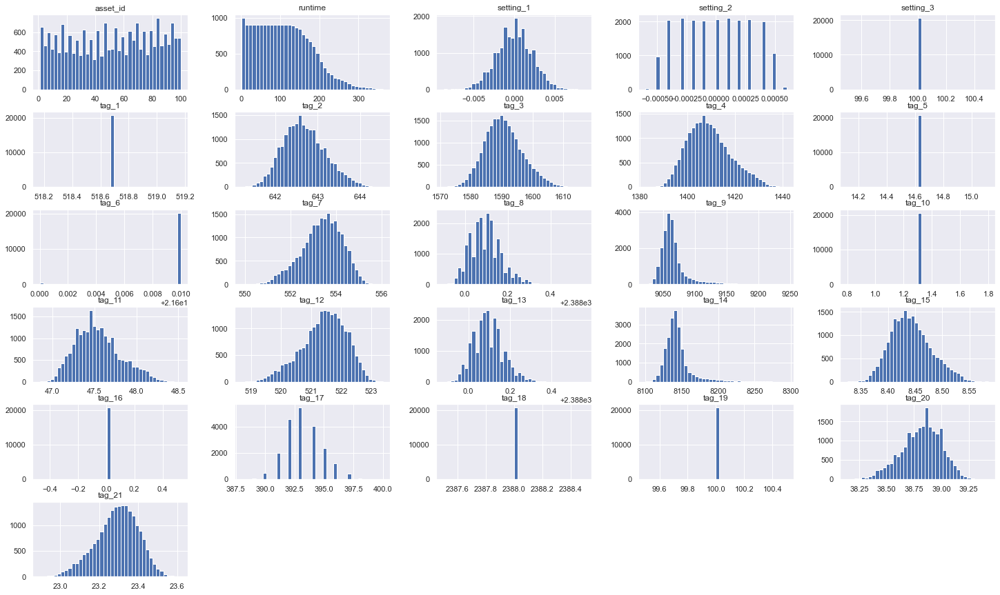

In [13]:
df2.hist(bins=40)
plt.show()

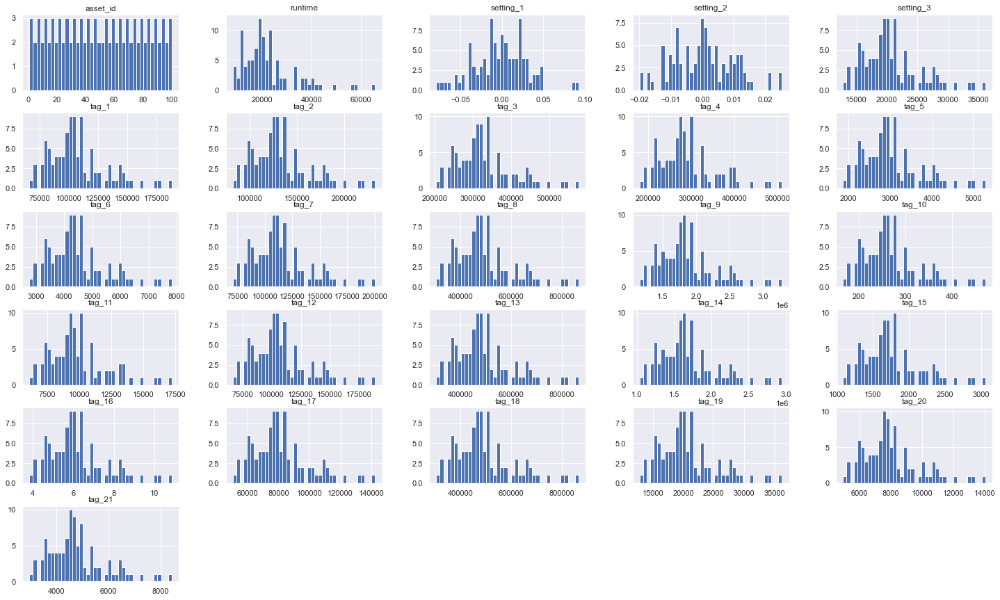

In [14]:
df2_sum = df2.groupby('asset_id').sum().reset_index()
df2_sum.hist(bins=40)
plt.show()

## 2.2. Análise bivariada

### 2.2.1. Features "tag"

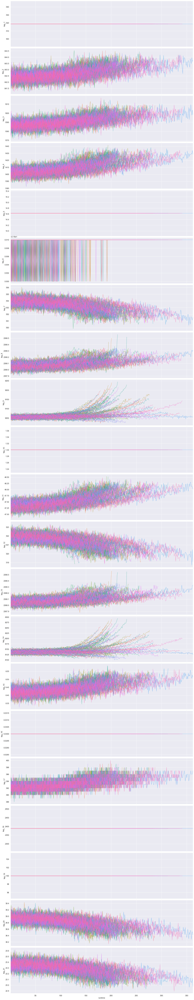

In [15]:
ax = sns.PairGrid(data=df2, x_vars='runtime', y_vars=cols_tag, hue='asset_id', height=4, aspect=4)
ax.map(plt.plot, alpha=0.5)
ax.set(xlim=(df2['runtime'].min(), df2['runtime'].max()))

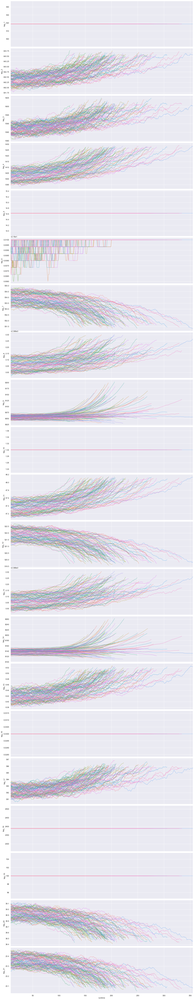

In [16]:
# Suavização das curvas para as features "tag"
aux1 = df2.rolling(15).mean()

ax = sns.PairGrid(data=aux1, x_vars='runtime', y_vars=cols_tag, hue='asset_id', height=4, aspect=4)
ax.map(plt.plot, alpha=0.5)
ax.set(xlim=(aux1['runtime'].min(), aux1['runtime'].max()))

**Algumas features parecem apresentar comportamentos similares, tendências a queda, alta, variação e etc.**

### 2.2.2. Análise de grupos features "tag"

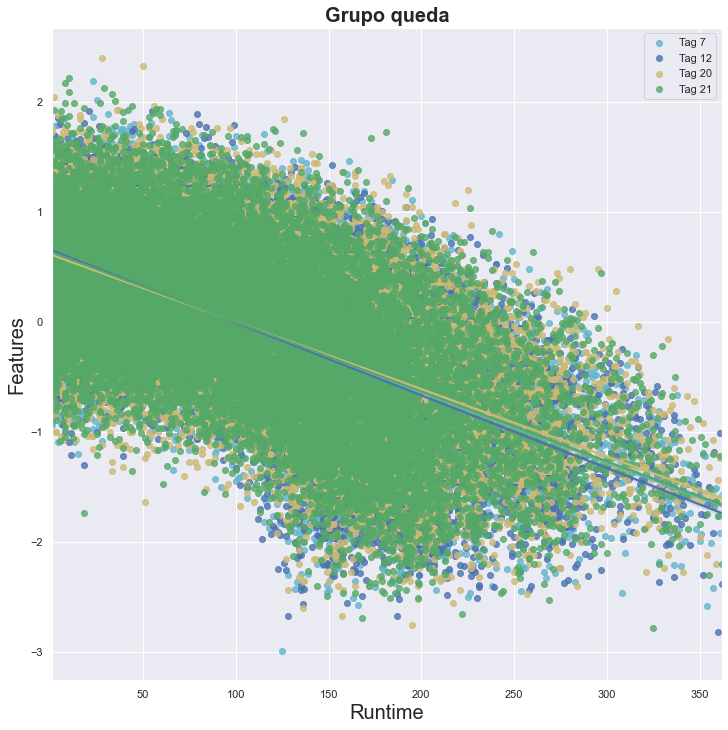

In [17]:
scaler = RobustScaler()

aux1 = df2.copy()
aux1.iloc[:,4:26] = scaler.fit_transform(aux1.iloc[:,4:26])

ax = plt.subplot(111)

sns.regplot(x='runtime',y='tag_7', color='c', label='Tag 7', data=aux1, ax=ax)
sns.regplot(x='runtime',y='tag_12', color='b', label='Tag 12', data=aux1, ax=ax)
sns.regplot(x='runtime',y='tag_20', color='y', label='Tag 20', data=aux1, ax=ax)
sns.regplot(x='runtime',y='tag_21', color='g', label='Tag 21', data=aux1, ax=ax)

ax.set_xlabel('Runtime',fontsize=20)
ax.set_ylabel('Features',fontsize=20)
ax.figure.set_size_inches(12, 12)
ax.set_title('Grupo queda', fontsize=20, fontweight='bold')
ax.legend(loc='best')
savefig('Grupo_queda_tag.png', bbox_inches='tight')
plt.show()



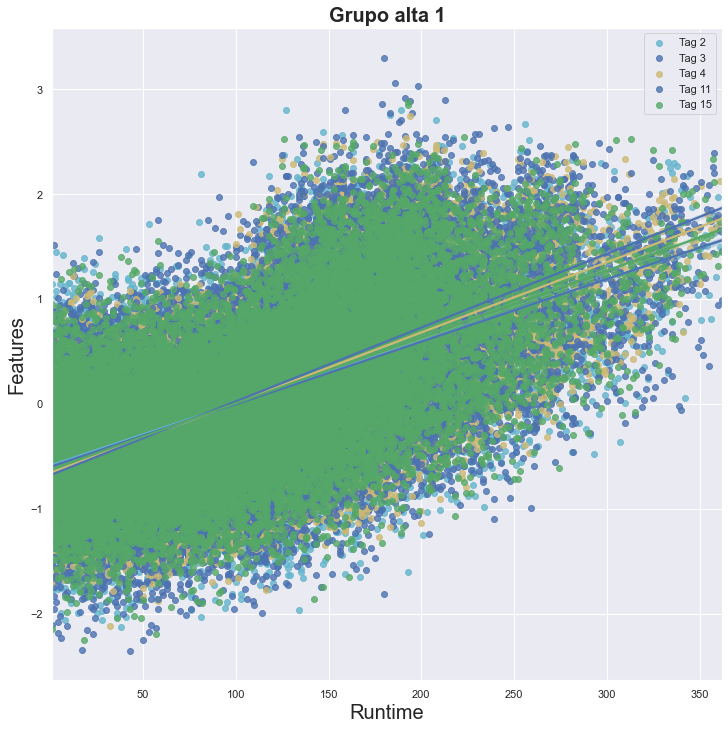

In [18]:
ax = plt.subplot(111)

sns.regplot(x='runtime',y='tag_2', color='c', label='Tag 2', data=aux1, ax=ax)
sns.regplot(x='runtime',y='tag_3', color='b', label='Tag 3', data=aux1, ax=ax)
sns.regplot(x='runtime',y='tag_4', color='y', label='Tag 4', data=aux1, ax=ax)
#sns.regplot(x='runtime',y='tag_8', color='g', label='Tag 8', data=aux1, ax=ax)
sns.regplot(x='runtime',y='tag_11', color='b', label='Tag 11', data=aux1, ax=ax)
#sns.regplot(x='runtime',y='tag_13', color='m', label='Tag 13', data=aux1, ax=ax)
sns.regplot(x='runtime',y='tag_15', color='g', label='Tag 15', data=aux1, ax=ax)
            
ax.set_xlabel('Runtime',fontsize=20)
ax.set_ylabel('Features',fontsize=20)
ax.figure.set_size_inches(12, 12)
ax.set_title('Grupo alta 1', fontsize=20, fontweight='bold')
ax.legend(loc='best')
savefig('Grupo_alta1_tag.png', bbox_inches='tight')
plt.show()


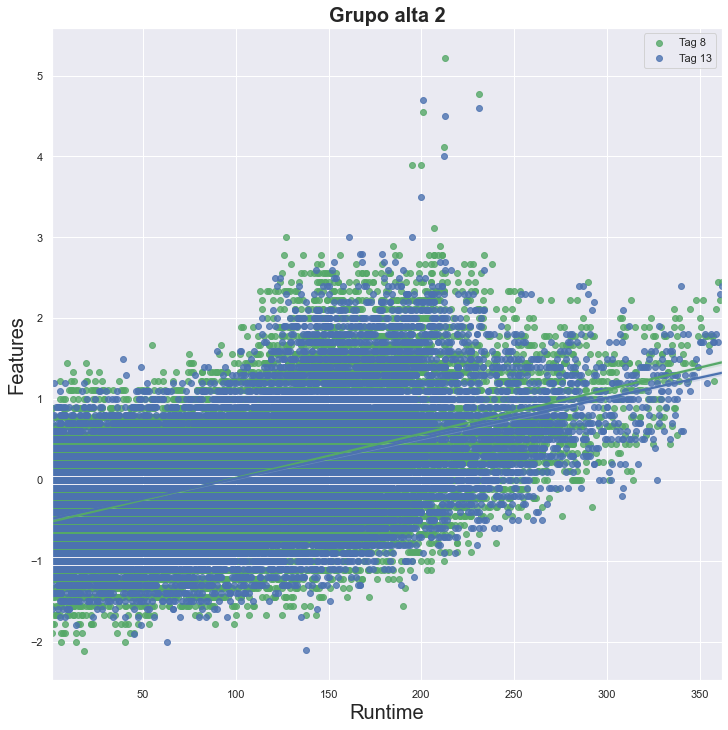

In [19]:
ax = plt.subplot(111)
sns.regplot(x='runtime',y='tag_8', color='g', label='Tag 8', data=aux1, ax=ax)
sns.regplot(x='runtime',y='tag_13', color='b', label='Tag 13', data=aux1, ax=ax)

ax.set_xlabel('Runtime',fontsize=20)
ax.set_ylabel('Features',fontsize=20)
ax.figure.set_size_inches(12, 12)
ax.set_title('Grupo alta 2', fontsize=20, fontweight='bold')
ax.legend(loc='best')
savefig('Grupo_alta2_tag.png', bbox_inches='tight')
plt.show()

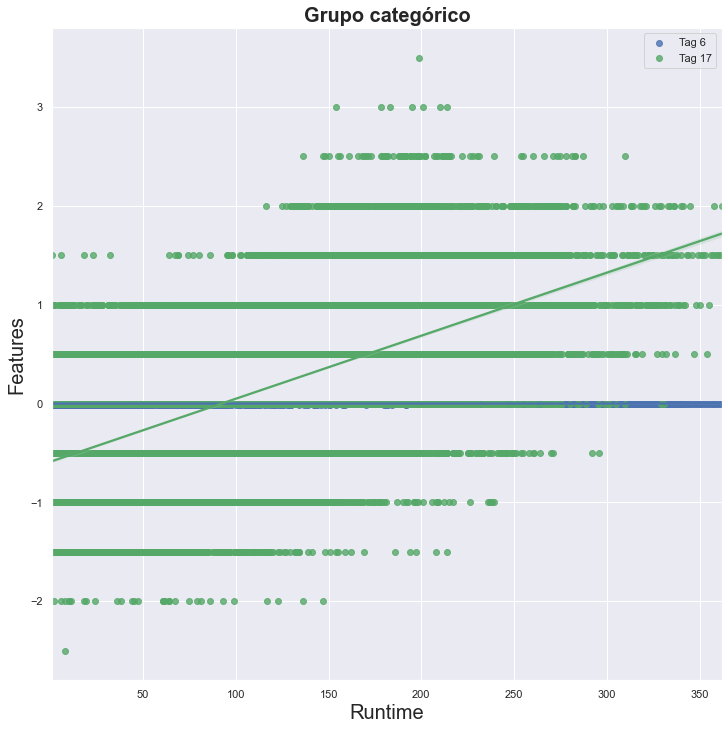

In [20]:
ax = plt.subplot(111)
sns.regplot(x='runtime',y='tag_6', color='b', label='Tag 6', data=aux1, ax=ax)
sns.regplot(x='runtime',y='tag_17', color='g', label='Tag 17', data=aux1, ax=ax)

ax.set_xlabel('Runtime',fontsize=20)
ax.set_ylabel('Features',fontsize=20)
ax.figure.set_size_inches(12, 12)
ax.set_title('Grupo categórico', fontsize=20, fontweight='bold')
ax.legend(loc='best')
savefig('Grupo_categorico.png', bbox_inches='tight')
plt.show()

**As features possuem uma tendência crescente, e aparentemente se comportam como dados categóricos**

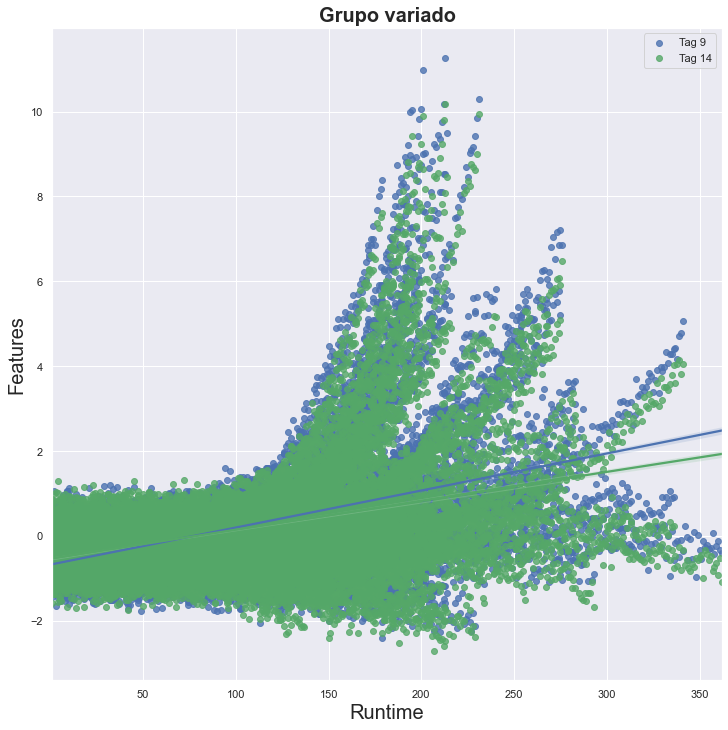

In [21]:
ax = plt.subplot(111)
sns.regplot(x='runtime',y='tag_9', color='b', label='Tag 9', data=aux1, ax=ax)
sns.regplot(x='runtime',y='tag_14', color='g', label='Tag 14', data=aux1, ax=ax)

ax.set_xlabel('Runtime',fontsize=20)
ax.set_ylabel('Features',fontsize=20)
ax.figure.set_size_inches(12, 12)
ax.set_title('Grupo variado', fontsize=20, fontweight='bold')
ax.legend(loc='best')
savefig('Grupo_variado_tag.png', bbox_inches='tight')
plt.show()


**Os dados começam lineares e no intervalo de 100-150 ciclos ocorre uma variação no seu comportamento, podemos ver algo próximo de curvas exponenciais, curvas levemente crescentes, lineares, e até mesmo leve queda**

### 2.2.3. Features "setting"

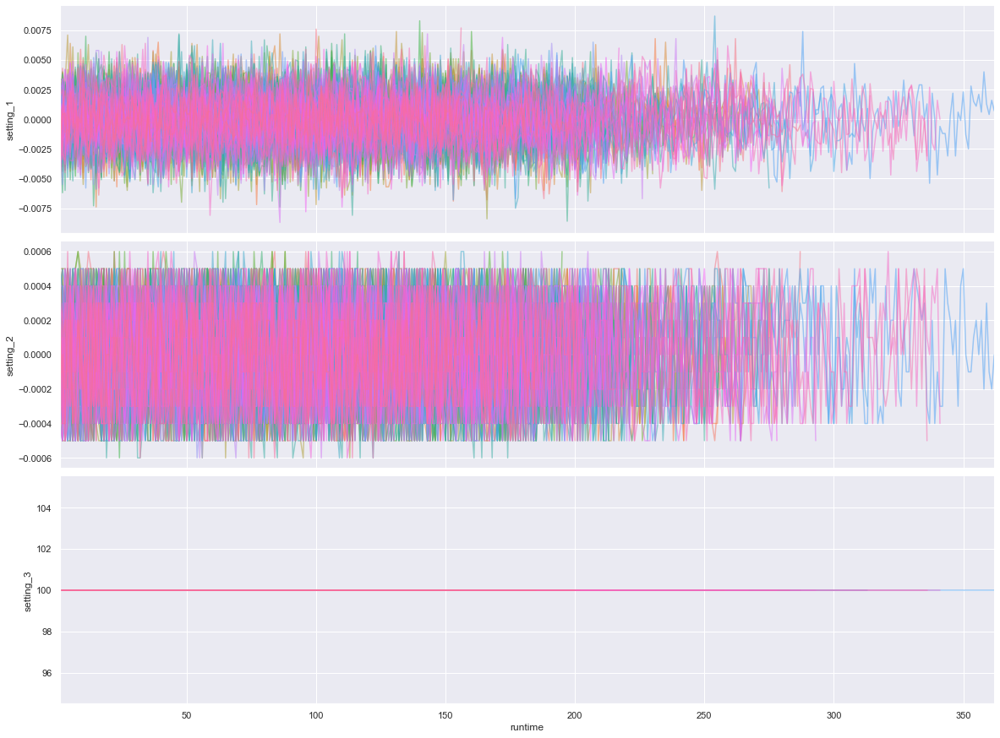

In [22]:
ax = sns.PairGrid(data=df2, x_vars='runtime', y_vars=cols_setting, hue='asset_id', height=4, aspect=4)
ax.map(plt.plot, alpha=0.5)
ax.set(xlim=(df2['runtime'].min(), df2['runtime'].max()))

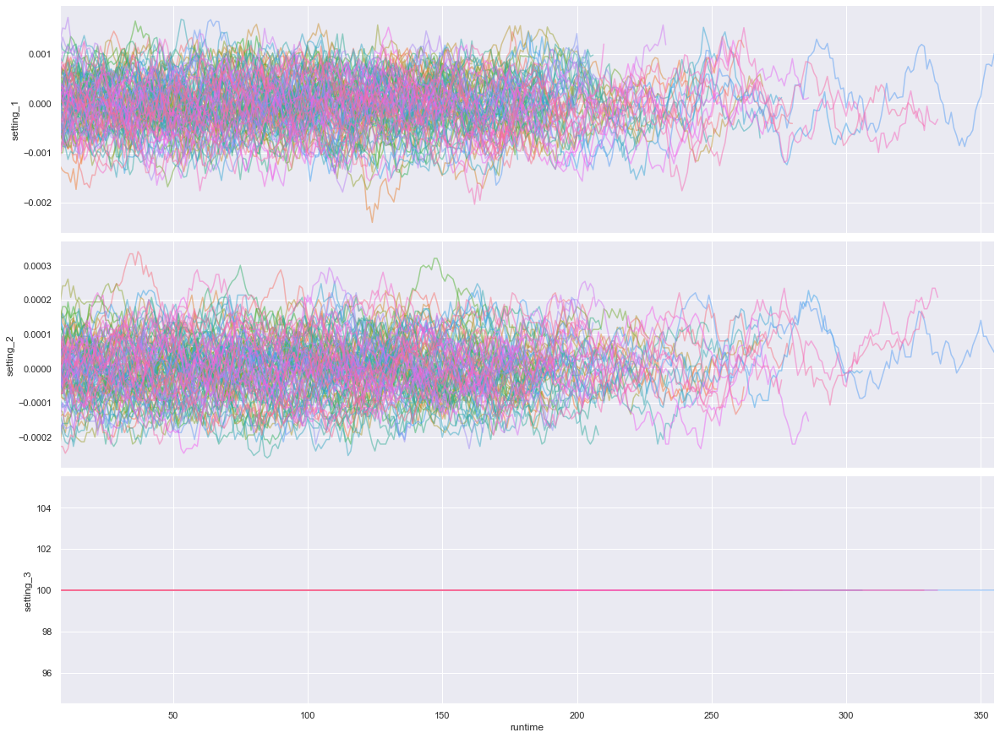

In [23]:
# Suavização das curvas para as features "setting"
aux1 = df2.rolling(15).mean()

ax = sns.PairGrid(data=aux1, x_vars='runtime', y_vars=cols_setting, hue='asset_id', height=4, aspect=4)
ax.map(plt.plot, alpha=0.5 )
ax.set(xlim=( aux1['runtime'].min(), aux1['runtime'].max()))

### 2.2.4. Análise de grupos features "setting"

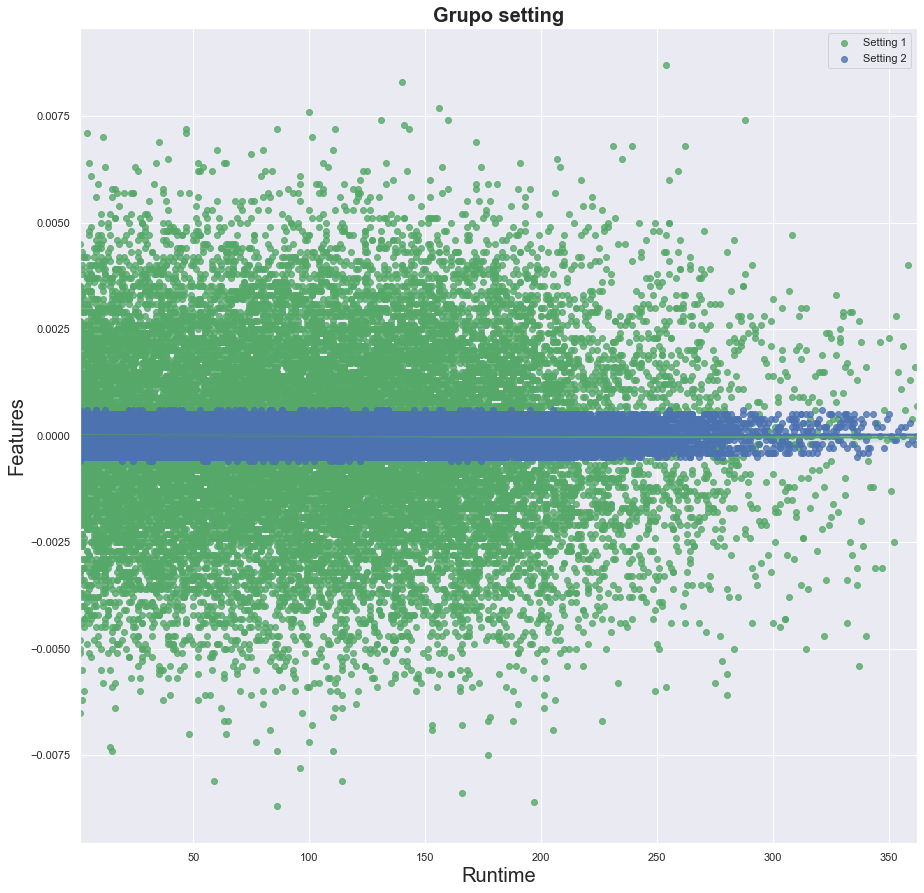

In [24]:
aux1 = df2.copy()
ax = plt.subplot(111)

sns.regplot(x='runtime',y='setting_1', color='g', label='Setting 1', data=aux1, ax=ax)
sns.regplot(x='runtime',y='setting_2', color='b', label='Setting 2', data=aux1, ax=ax)

ax.set_xlabel('Runtime',fontsize=20)
ax.set_ylabel('Features',fontsize=20)
ax.figure.set_size_inches(15, 15)
ax.set_title('Grupo setting', fontsize=20, fontweight='bold')
ax.legend(loc='best')
savefig('Grupo_setting.png', bbox_inches='tight')
plt.show()

In [25]:
# Podemos observar que as features setting_3, tag_1, tag_5, tag_10, tag_16, tag_18, tag_19, são valores constantes, então já serão retiradas do dataset
cols_drop = ['setting_3', 'tag_1', 'tag_5', 'tag_10', 'tag_16', 'tag_18', 'tag_19']

df2.drop(cols_drop, inplace=True, axis=1)
df2.head()

,asset_id,runtime,setting_1,setting_2,tag_2,tag_3,tag_4,tag_6,tag_7,tag_8,tag_9,tag_11,tag_12,tag_13,tag_14,tag_15,tag_17,tag_20,tag_21
0,1,1,-0.0007,-0.0004,641.82,1589.70,1400.60,21.61,554.36,2388.06,9046.19,47.47,521.66,2388.02,8138.62,8.4195,392,39.06,23.4190
1,1,2,0.0019,-0.0003,642.15,1591.82,1403.14,21.61,553.75,2388.04,9044.07,47.49,522.28,2388.07,8131.49,8.4318,392,39.00,23.4236
2,1,3,-0.0043,0.0003,642.35,1587.99,1404.20,21.61,554.26,2388.08,9052.94,47.27,522.42,2388.03,8133.23,8.4178,390,38.95,23.3442
3,1,4,0.0007,0.0000,642.35,1582.79,1401.87,21.61,554.45,2388.11,9049.48,47.13,522.86,2388.08,8133.83,8.3682,392,38.88,23.3739
4,1,5,-0.0019,-0.0002,642.37,1582.85,1406.22,21.61,554.00,2388.06,9055.15,47.28,522.19,2388.04,8133.80,8.4294,393,38.90,23.4044


## 2.3. Análise multivariada

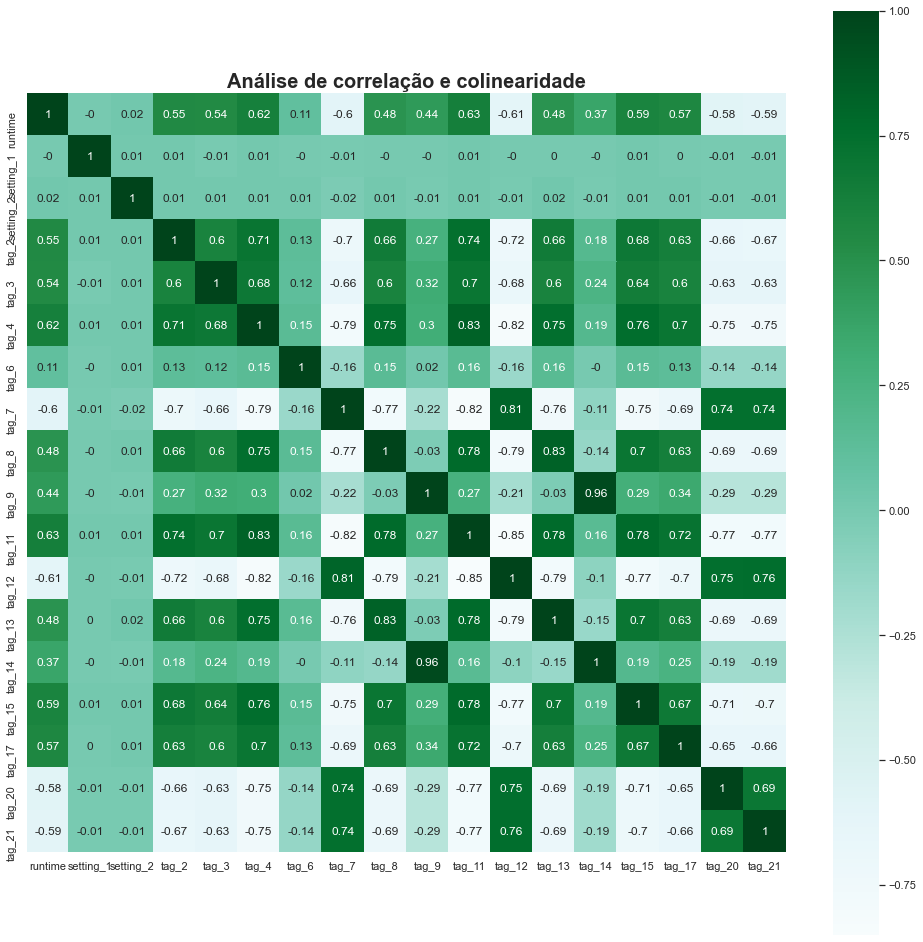

In [26]:
aux1 = df2.drop(columns = 'asset_id')
corr = aux1.corr(method = 'pearson').round(2)

ax = sns.heatmap(corr, annot=True, square=True, cmap='BuGn')
ax.figure.set_size_inches(17, 17)
ax.set_title('Análise de correlação e colinearidade', fontsize=20, fontweight='bold')
savefig('Analise_correlacao.png', bbox_inches='tight')
sns.despine(bottom=True, left=True)

In [27]:
# Features com alta colinearidade +- 0.80
# Colinearidade alta positiva tag_4 - tag_11, tag_7 - tag_12, tag_8 - tag_13, tag_9 - tag_14
# Colinearidade alta negativa tag_4 - tag_12, tag_7 - tag_11, tag_11 - tag_12

**Conclusões**

    As features possuem agrupamentos claros entre si, indicando comportamentos próximos.
    Apesar dos agrupamentos, possuem escalas diferentes de valores, o que pode ser bons indicativos
    para utilização de técnicas de rescaling de dados.
    
    Na maioria dos agrupamentos, nota-se variações grandes no comportamento (queda, alta e etc) dos sensores,
    variações essas, que levam à falha dos ativos.
    
    Temos uma alta colinearidade entre diversas features, alguns testes de feature engineering entre essas features
    serão realizados, porém, para a seleção final de features, será utilizado o algoritmo Boruta para uma melhor
    tomada de decisão.

# 3.0 Feature Engineering

Para realizar a previsão, duas features novas serão criadas. Target_reg, que é a contagem decrescente de ciclos, e a target_cla, que servirá como classificador para os assets nos ultimos 20 ciclos

In [28]:
df3 = df2.copy()

In [29]:
# Criando feature target_reg com a contagem decrescente da feature runtime
runtime_max = df3.groupby(['asset_id'])['runtime'].max().reset_index()
df3 = pd.merge(df3, runtime_max, how='inner', on='asset_id')
df3['target_reg'] = df3['runtime_y'] - df3['runtime_x']
df3.rename(columns = {'runtime_x': 'runtime'}, inplace=True)
df3.drop(columns='runtime_y', inplace = True)

# Criando feature target_cla para capturar os assets nos ultimos 20 ciclos
df3['target_cla'] = df3['target_reg'].apply(lambda x: 1 if x < 20 else 0)

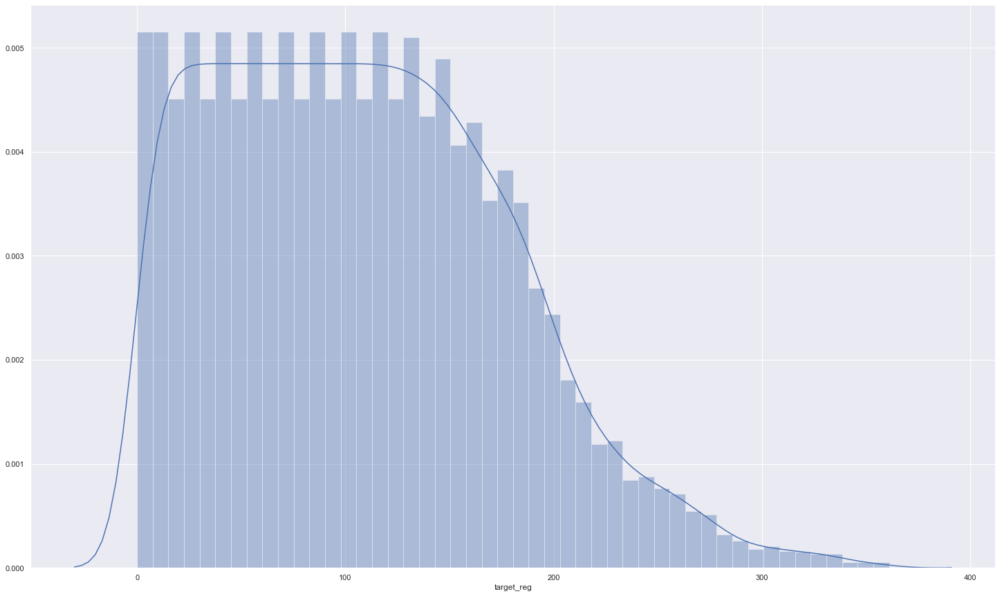

In [30]:
# Distribuição feature target_reg
sns.distplot(df3['target_reg'])

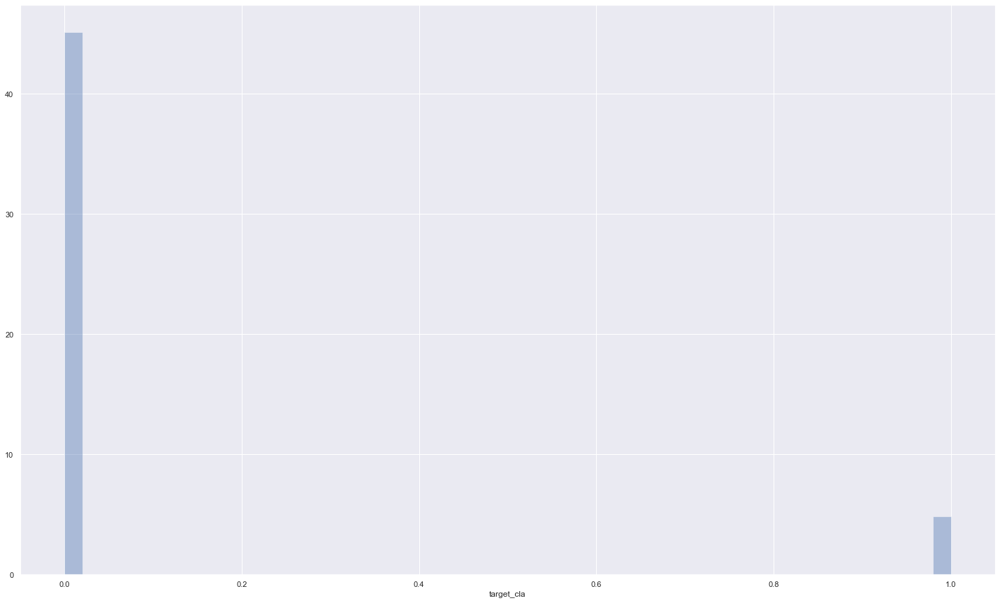

In [31]:
# Distribuição feature target_cla
sns.distplot(df3['target_cla'])

# 4.0. Seleção de features

Como dito acima, o Algoritmo boruta servirá como base principal para seleção das features de maior importância

In [32]:
df4 = df3.copy()

## 4.1. Algoritmo Boruta

### 4.1.1. Features para Regressão

In [33]:
# # Dados de treino e teste para o Boruta
# X_treino_bo = df4.drop(columns = ['target_reg','target_cla','asset_id']).values
# y_teste_bo = df4['target_reg'].values.ravel()

# # Instanciando o Random Forest para passar como parâmetro de seleção para o Algoritmo Boruta
# rf = RandomForestRegressor(n_jobs=-1)

# # Definindo Boruta com os parâmetros
# boruta = BorutaPy(rf, n_estimators='auto', verbose=2, random_state=42).fit(X_treino_bo, y_teste_bo)

In [34]:
# # Lista com as colunas selecionadas pelo Boruta
# cols_selec_reg = boruta.support_.tolist()

# # Melhores Features
# X_train_bo = df4.drop(columns = ['target_reg','target_cla','asset_id'])
# cols_selec_boruta_reg = X_train_bo.iloc[:, cols_selec_reg].columns.to_list()

# # Features não selecionadas
# cols_n_selec_boruta_reg = list(np.setdiff1d(X_train_bo.columns, cols_selec_boruta_reg))

In [35]:
cols_selec_boruta_reg = ['runtime', 'tag_2', 'tag_3', 'tag_4', 'tag_7', 'tag_8', 'tag_9', 'tag_11',
                          'tag_12', 'tag_13', 'tag_14', 'tag_15', 'tag_20', 'tag_21']

### 4.1.2. Features para Classificação

In [36]:
# # Dados de treino e teste para o Boruta
# X_treino_bo = df4.drop(columns = ['target_reg','target_cla','asset_id']).values
# y_teste_bo = df4['target_cla'].values.ravel()

# # Instanciando o Random Forest para passar como parâmetro de seleção para o Algoritmo Boruta
# rf = RandomForestClassifier(n_jobs=-1)

# # Definindo Boruta com os parâmetros
# boruta = BorutaPy(rf, n_estimators='auto', verbose=2, random_state=42).fit(X_treino_bo, y_teste_bo)

In [37]:
# # Lista com as colunas selecionadas pelo Boruta
# cols_selec_cla = boruta.support_.tolist()

# # Melhores features
# X_train_bo = df4.drop(columns =  ['target_reg','target_cla','asset_id'])
# cols_selec_boruta_cla = X_train_bo.iloc[:, cols_selec_cla].columns.to_list()

# # Features não selecionadas
# cols_n_selec_boruta_cla = list(np.setdiff1d(X_train_bo.columns, cols_selec_boruta_cla))

In [38]:
cols_selec_boruta_cla = ['runtime', 'tag_2', 'tag_3', 'tag_4', 'tag_7', 'tag_8', 'tag_9', 'tag_11',
                          'tag_12', 'tag_13', 'tag_14', 'tag_15', 'tag_20', 'tag_21']

# 5.0. Pré-processamento dos dados

Etapa para transformar as features para a mesma escala, melhorando a performance dos modelos de machine learning

In [39]:
df5_reg = df4.copy()
df5_cla = df4.copy()

## 5.1. Scaling

In [40]:
# Scaling das features utilizando RobustScaler
scaler_x_reg = RobustScaler()
scaler_y_reg = RobustScaler()
scaler_x_cla = RobustScaler()
scaler_y_cla = RobustScaler()


#df4.iloc[:,1:19] = scaler_x.fit_transform(df4.iloc[:,1:19])

# Scaling das features de treino
df5_reg[cols_selec_boruta_reg] = scaler_x_reg.fit_transform(df5_reg[cols_selec_boruta_reg])
#df4_cla[cols_selec_boruta_cla] = scaler_x_cla.fit_transform(df4_cla[cols_selec_boruta_cla])

# df4[cols] = scaler_x.fit_transform(df4[cols])

# Salvando scaling x
#pickle.dump(scaler_x_reg, open('parametros/scaler_x_reg.pkl', 'wb'))

# Scaling da feature resposta target_reg
df5_reg['target_reg'] = scaler_y_reg.fit_transform(df5_reg[['target_reg']].values)

# Salvando scaling y
#pickle.dump(scaler_y_reg, open('parametros/scaler_y_reg.pkl', 'wb'))

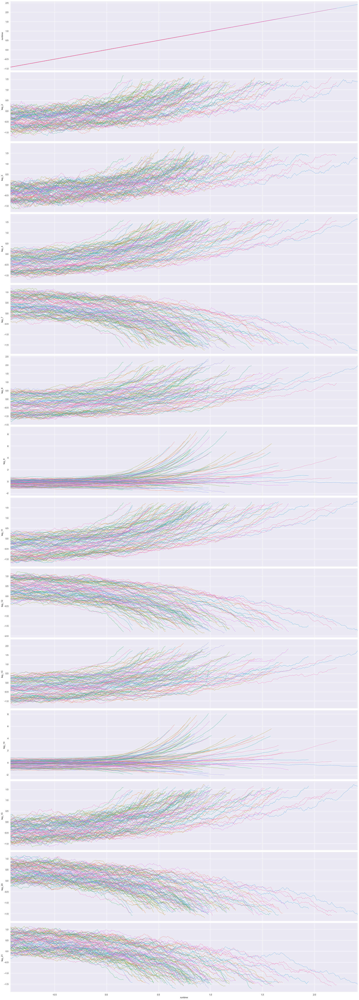

In [41]:
# Visualizando os dados com scaling, podemos observar que seu comportamento se manteve o mesmo em relação aos dados sem scaling
aux1 = df5_reg.rolling(15).mean()
ax = sns.PairGrid(data=aux1, x_vars='runtime', y_vars=df5_reg[cols_selec_boruta_reg].columns, hue='asset_id', height=5, aspect=5)
ax.map(plt.plot, alpha=0.5)
ax.set(xlim=(aux1['runtime'].min(), aux1['runtime'].max()))

## 5.2. Transformação da variavel resposta

Tranformação da variavel resposta para um melhor fit do modelo. Essa técnica mostrou ter uma melhora grande nas métricas dos modelos

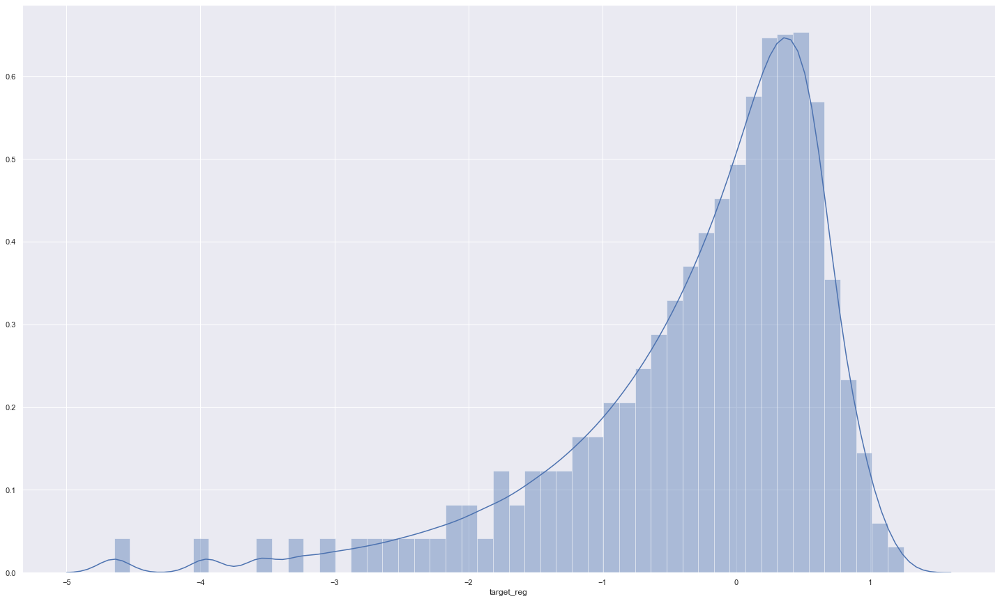

In [42]:
df5_reg['target_reg'] = np.log1p(df5_reg['target_reg'])
sns.distplot(df5_reg['target_reg'])

# 6.0. Modelagem Machine Learning

Nessa etapa serão testados alguns dos modelos de Machine Learning mais classicos para avaliação dos modelos e base comparativa

In [43]:
df6_reg = df5_reg.copy()

## 6.1. Regressão

### 6.1.1. Regressão Linear

In [44]:
# Instancia
model_lr_reg = LinearRegression()

# Validação cruzada
lr_results_reg = validacao_cruzada_reg(df6_reg, cols_selec_boruta_reg, ['target_reg'], 5, 'Regressão Linear', model_lr_reg, verbose=False)
lr_results_reg

,Nome modelo,MAE CV,RMSE CV,R2 CV
0,Regressão Linear,35.3 +/- 6.54,49.17 +/- 7.62,0.77 +/- 0.05


### 6.1.2. Regressão Lasso

In [45]:
# Instancia
model_ls_reg = Lasso(alpha=0.01)

# Validação cruzada
ls_results_reg = validacao_cruzada_reg(df6_reg, cols_selec_boruta_reg, ['target_reg'], 5, 'Regressão Lasso', model_ls_reg, verbose=False)
ls_results_reg

,Nome modelo,MAE CV,RMSE CV,R2 CV
0,Regressão Lasso,34.75 +/- 6.72,48.34 +/- 8.1,0.77 +/- 0.05


### 6.1.3. Random Forest Regressão

In [46]:
# Instancia
model_rf_reg = RandomForestRegressor()

# Validação cruzada
rf_results_reg = validacao_cruzada_reg(df6_reg, cols_selec_boruta_reg, ['target_reg'], 5, 'Random Forest Regressão', model_rf_reg, verbose=True)
rf_results_reg


KFold numero: 1

KFold numero: 2

KFold numero: 3

KFold numero: 4

KFold numero: 5


,Nome modelo,MAE CV,RMSE CV,R2 CV
0,Random Forest Regressão,26.26 +/- 6.82,37.1 +/- 10.75,0.87 +/- 0.03


### 6.1.4. XGBoost Regressão

In [47]:
# Instancia
model_xgb_reg = xgb.XGBRegressor(objective='reg:squarederror',
                             n_estimators=50, 
                             eta=0.01,
                             max_depth=10,
                             subsample=0.7,
                             colsample_bytee=0.9)

# Validação cruzada
xgb_results_reg = validacao_cruzada_reg(df6_reg, cols_selec_boruta_reg, ['target_reg'], 5, 'XGBoost Regressão', model_xgb_reg, verbose=True)
xgb_results_reg


KFold numero: 1

KFold numero: 2

KFold numero: 3

KFold numero: 4

KFold numero: 5


,Nome modelo,MAE CV,RMSE CV,R2 CV
0,XGBoost Regressão,26.65 +/- 6.61,37.55 +/- 10.42,0.87 +/- 0.03


### 6.1.5. Comparação entre os modelos de regressão

In [48]:
results_geral_reg = pd.concat([lr_results_reg, ls_results_reg, rf_results_reg, xgb_results_reg])
results_geral_reg

,Nome modelo,MAE CV,RMSE CV,R2 CV
0,Regressão Linear,35.3 +/- 6.54,49.17 +/- 7.62,0.77 +/- 0.05
0,Regressão Lasso,34.75 +/- 6.72,48.34 +/- 8.1,0.77 +/- 0.05
0,Random Forest Regressão,26.26 +/- 6.82,37.1 +/- 10.75,0.87 +/- 0.03
0,XGBoost Regressão,26.65 +/- 6.61,37.55 +/- 10.42,0.87 +/- 0.03


## 6.2. Modelo Final Regressão - XGBoost Regressor

O modelo escolhido para realização da regressão foi o XGBoost, por se tratar de um algoritmo com performance boa e custo computacional mais acessivel em relação ao tamanho final do arquivo

In [49]:
cols_selec_boruta_full_reg = cols_selec_boruta_reg.copy()
cols_selec_boruta_full_reg.extend(['asset_id'])

In [50]:
numero_asset = len(df6_reg['asset_id'].drop_duplicates())

numero_asset_val = range(40, 60)
numero_asset_treino = [x for x in range(numero_asset) if x not in numero_asset_val]

In [51]:
dados_treino = df6_reg[df6_reg['asset_id'].isin(numero_asset_treino)]
dados_val = df6_reg[df6_reg['asset_id'].isin(numero_asset_val)]

X_treino_reg, y_treino_reg = dados_treino[cols_selec_boruta_full_reg], dados_treino['target_reg'] 
X_val_reg, y_val_reg = dados_val[cols_selec_boruta_full_reg], dados_val['target_reg']

In [52]:
model_xgb_final = xgb.XGBRegressor(objective='reg:squarederror',
                                   n_estimators=100, 
                                   eta=0.01,
                                   max_depth=10,
                                   subsample=0.7,
                                   colsample_bytee=0.9)

X_treino_f_reg = X_treino_reg.drop(columns='asset_id').copy()
X_val_f_reg = X_val_reg.drop(columns='asset_id').copy()

m_reg = model_xgb_final.fit(X_treino_f_reg, y_treino_reg)
score_reg = m_reg.score(X_val_f_reg, y_val_reg)

# Predição
yhat_reg = m_reg.predict(X_val_f_reg)

# Voltando os dados ao normal
yhat_reg = np.expm1(yhat_reg)
yhat_reg = scaler_y_reg.inverse_transform(yhat_reg.reshape(-1,1))       
y_val_reg = np.expm1(y_val_reg)
y_val_reg = scaler_y_reg.inverse_transform(pd.DataFrame(y_val_reg.values.tolist()).values)
        
erro_reg = ml_error('XGBoost Final', y_val_reg, yhat_reg)
erro_reg['SCORE'] = score_reg

erro_reg

,Nome modelo,MAE,RMSE,SCORE
0,XGBoost Final,21.487884,30.518205,0.887337


In [53]:
X_treino_reg_full = df6_reg[cols_selec_boruta_reg]
Y_treino_reg_full = df6_reg['target_reg']

model_xgb_reg_final_export = xgb.XGBRegressor(objective='reg:squarederror',
                                          n_estimators=100, 
                                          eta=0.01,
                                          max_depth=10,
                                          subsample=0.7,
                                          colsample_bytee=0.9).fit(X_treino_reg_full, Y_treino_reg_full)

In [54]:
# Salvando modelo pickle de regressão
# pickle.dump(model_xgb_reg_final_export, open('C:/Users/luuca/Documents/Projetos/Python/Case Suzano/model/suzano_reg_model.pkl','wb'))

### 6.2.1. Avaliação de Performance - Regressão

In [55]:
df_reg = X_val_reg.copy()

In [56]:
df_reg['target'] = y_val_reg.copy()
df_reg['target_pred'] = floor(yhat_reg.copy())
df_reg['erro'] = df_reg['target_pred'] - df_reg['target']

In [57]:
df_reg[cols_selec_boruta_reg] = scaler_x_reg.inverse_transform(df_reg[cols_selec_boruta_reg])

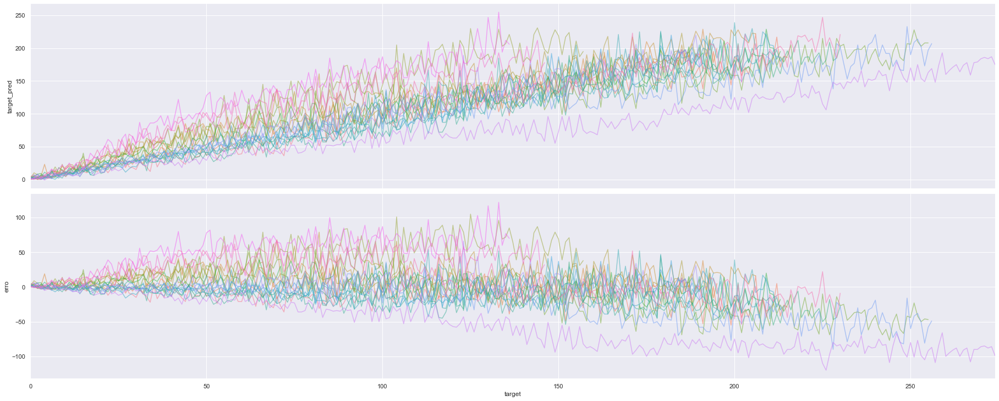

In [58]:
df_plot = df_reg.copy()
df_plot = df_plot.sort_values(['asset_id', 'runtime'])
ax = sns.PairGrid(data=df_plot, x_vars="target", y_vars=['target_pred', 'erro'], hue="asset_id", height=5, aspect=5)
ax.map(plt.plot, alpha=0.5)
ax.set(xlim=(df_plot['target'].min(),df_plot['target'].max()))
savefig('Analise_residuos_regressao.png', bbox_inches='tight')

### 6.2.2. Aplicando modelo de regressão nos dados de teste

In [59]:
df_reg_teste = pd.read_table('data/PM_test.txt',sep='\s+', header = None)
df_reg_teste.columns = cols_final
df_reg_teste[cols_selec_boruta_reg] = scaler_x_reg.fit_transform(df_reg_teste[cols_selec_boruta_reg])

In [60]:
model_reg = pickle.load(open('C:/Users/luuca/Documents/Projetos/Python/Case Suzano/model/suzano_reg_model.pkl', 'rb'))
X_val_f_reg = df_reg_teste[cols_selec_boruta_reg].copy()

# Predição
yhat_reg = model_reg.predict(X_val_f_reg)

# Voltando os dados ao normal
yhat_reg = np.expm1(yhat_reg)
yhat_reg = scaler_y_reg.inverse_transform(yhat_reg.reshape(-1,1)) 

df_reg_teste['predicted'] = yhat_reg.copy()

In [61]:
len_ini = df_reg_teste['asset_id'].drop_duplicates().iloc[0]
len_fim = df_reg_teste['asset_id'].drop_duplicates().iloc[-1]

data_reg = pd.DataFrame()

for i in range(len_ini, len_fim+1):
    data_reg = data_reg.append(df_reg_teste[df_reg_teste['asset_id']==i].iloc[-1,:])

In [62]:
data_reg_export = round(data_reg['predicted'],3)

In [63]:
#data_reg_export.to_csv('C:/Users/luuca/Documents/Projetos/Python/Case Suzano/regressao_lucas_alves_rodrigues.csv', index= False)

## 6.3. Classificação

### 6.3.1. Random Forest Classificação

In [64]:
df6_cla = df5_cla.copy()

In [65]:
# Instancia
model_rf_cla = RandomForestClassifier()

validacao_cruzada_cla(df6_cla, cols_selec_boruta_cla, 'target_cla', 5, "Random Forest Classificação", model_rf_cla, verbose=True)


KFold numero: 1

KFold numero: 2

KFold numero: 3

KFold numero: 4

KFold numero: 5


,Nome modelo,Acuracia,Roc,Precisao,Recall,F1
0,Random Forest Classificação,0.97 +/- 0.0,0.92 +/- 0.01,0.88 +/- 0.04,0.85 +/- 0.03,0.86 +/- 0.02


### 6.3.2. XGBoost Classificação

In [66]:
# Instancia
model_xgb_cla = xgb.XGBClassifier()

validacao_cruzada_cla(df6_cla, cols_selec_boruta_cla, 'target_cla', 5, "XGBoost Classificação", model_xgb_cla, verbose=True)


KFold numero: 1

KFold numero: 2

KFold numero: 3

KFold numero: 4

KFold numero: 5


,Nome modelo,Acuracia,Roc,Precisao,Recall,F1
0,XGBoost Classificação,0.97 +/- 0.0,0.92 +/- 0.01,0.87 +/- 0.04,0.86 +/- 0.03,0.86 +/- 0.01


## 6.4. Modelo Final Classificação - XGBoost Classifier

In [67]:
cols_selec_boruta_full_cla = cols_selec_boruta_cla.copy()
cols_selec_boruta_full_cla.extend(['asset_id'])

In [68]:
numero_asset = len(df6_cla['asset_id'].drop_duplicates())

numero_asset_val = range(50, 70)
numero_asset_treino = [x for x in range(numero_asset) if x not in numero_asset_val]

In [69]:
dados_treino = df6_cla[df6_cla['asset_id'].isin(numero_asset_treino)]
dados_val = df6_cla[df6_cla['asset_id'].isin(numero_asset_val)]

X_treino_cla, y_treino_cla = dados_treino[cols_selec_boruta_full_cla], dados_treino['target_cla'] 
X_val_cla, y_val_cla = dados_val[cols_selec_boruta_full_cla], dados_val['target_cla']

In [70]:
model_xgb_cla = xgb.XGBClassifier(objective='binary:logistic',
                                  n_estimators=100, 
                                  eta=0.01,
                                  max_depth=10,
                                  subsample=0.7,
                                  colsample_bytee=0.9)


X_treino_f_cla = X_treino_cla.drop(columns='asset_id').copy()
X_val_f_cla = X_val_cla.drop(columns='asset_id').copy()

m_cla = model_xgb_cla.fit(X_treino_f_cla, y_treino_cla)
score_cla = m_reg.score(X_val_f_cla, y_val_cla)

# Predição
yhat_cla = m_cla.predict(X_val_f_cla)

acuracia = accuracy_score(y_val_cla, yhat_cla)
roc = roc_auc_score(y_val_cla, yhat_cla)
precisao = precision_score(y_val_cla, yhat_cla)
recall = recall_score(y_val_cla, yhat_cla)
f1 = f1_score(y_val_cla, yhat_cla)

metricas_cla = pd.DataFrame({'Nome modelo': 'XGBoost Classificação',
                             'Acuracia': np.round(acuracia, 2),
                             'Roc': np.round(roc, 2) ,
                             'Precisao': np.round(precisao,2) ,
                             'Recall': np.round(recall, 2),
                             'F1': np.round(f1, 2)}, index = [0])
metricas_cla


,Nome modelo,Acuracia,Roc,Precisao,Recall,F1
0,XGBoost Classificação,0.97,0.93,0.84,0.88,0.86


In [71]:
X_treino_cla_full = df6_cla[cols_selec_boruta_cla]
Y_treino_cla_full = df6_cla['target_cla']

model_xgb_cla_final_export = xgb.XGBClassifier(objective='binary:logistic',
                                                  n_estimators=100, 
                                                  eta=0.01,
                                                  max_depth=10,
                                                  subsample=0.7,
                                                  colsample_bytee=0.9).fit(X_treino_cla_full, Y_treino_cla_full)

In [72]:
# Salvando o modelo pickle de classificação
#pickle.dump(model_xgb_cla_final_export, open('C:/Users/luuca/Documents/Projetos/Python/Case Suzano/model/suzano_cla_model.pkl','wb'))

### 6.4.1. Avaliação de Performance - Classificação

In [73]:
df_cla = X_val_cla.copy()

In [74]:
df_cla['target'] = y_val_cla.copy()
df_cla['target_pred'] = yhat_cla.copy()

In [75]:
cf_matrix = confusion_matrix(y_val_cla, yhat_cla)

In [76]:
print(classification_report(y_val_cla, yhat_cla))

              precision    recall  f1-score   support

           0       0.99      0.98      0.99      3882
           1       0.84      0.89      0.86       400

    accuracy                           0.97      4282
   macro avg       0.91      0.93      0.92      4282
weighted avg       0.97      0.97      0.97      4282



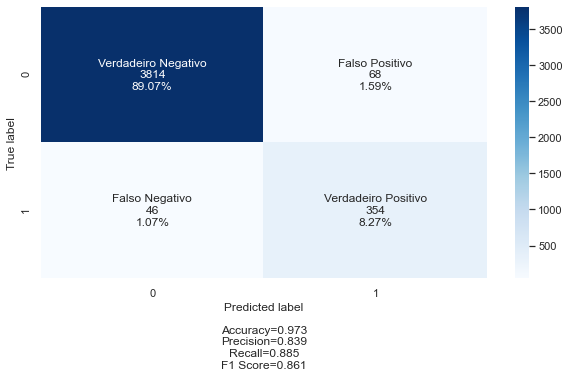

In [77]:
labels = ['Verdadeiro Negativo','Falso Positivo','Falso Negativo','Verdadeiro Positivo']
categories = ['0', '1']
plt.rcParams['figure.figsize'] = [10, 5]
make_confusion_matrix(cf_matrix, 
                      group_names=labels,
                      categories=categories, 
                      cmap='Blues')
savefig('Matriz_confusao_classificacao.png', bbox_inches='tight')

### 6.4.2. Aplicando modelo de classificação nos dados de teste

In [78]:
df_cla_teste = pd.read_table('data/PM_test.txt',sep='\s+', header = None)
df_cla_teste.columns = cols_final
df_cla_teste = df_cla_teste[cols_selec_boruta_full_cla]

In [79]:
model_cla = pickle.load(open('model/suzano_cla_model.pkl', 'rb'))
X_val_f_cla = df_cla_teste[cols_selec_boruta_cla].copy()

# Predição
yhat_cla = model_cla.predict_proba(X_val_f_cla)[:,1]

df_cla_teste['predicted'] = yhat_cla.copy()

ValueError: feature_names mismatch: ['runtime', 'tag_2', 'tag_3', 'tag_4', 'tag_7', 'tag_8', 'tag_9', 'tag_11', 'tag_12', 'tag_13', 'tag_14', 'tag_15', 'tag_17', 'tag_20', 'tag_21'] ['runtime', 'tag_2', 'tag_3', 'tag_4', 'tag_7', 'tag_8', 'tag_9', 'tag_11', 'tag_12', 'tag_13', 'tag_14', 'tag_15', 'tag_20', 'tag_21']
expected tag_17 in input data

In [ ]:
len_ini = df_cla_teste['asset_id'].drop_duplicates().iloc[0]
len_fim = df_cla_teste['asset_id'].drop_duplicates().iloc[-1]

data_cla = pd.DataFrame()

for i in range(len_ini, len_fim+1):
    data_cla = data_cla.append(df_cla_teste[df_cla_teste['asset_id']==i].iloc[-1,:])

In [ ]:
data_cla_export = round(data_cla['predicted'],5)

In [ ]:
#data_cla_export.to_csv('C:/Users/luuca/Documents/Projetos/Python/Case Suzano/classificacao_lucas_alves_rodrigues.csv', index= False)

# Teste API

In [ ]:
import requests

In [ ]:
# Carregando dados de teste
df_teste = pd.read_table('data/PM_test.txt',sep='\s+', header = None)

In [ ]:
df_teste.columns = cols_final

In [ ]:
#df_teste = df_teste[df_teste['asset_id']==49]

In [ ]:
data = json.dumps(df_teste.to_dict(orient='records'))

In [ ]:
# Chamada da API
url = 'https://predictive-main.herokuapp.com/maintenance/predict'
header = {'Content-type': 'application/json'}
data = data

# Utilizando método post
r = requests.post(url, data=data, headers=header)
print('Status Code {}'.format(r.status_code))

In [ ]:
d1 = pd.DataFrame(r.json(), columns = r.json()[0].keys())

In [ ]:
d1[d1['asset_id'] == 80]

In [ ]:
d2 = d1.iloc[-1]

In [ ]:
print('Probabilidade de falha do Ativo número {} é de {} com {} ciclos restantes de vida útil '.format(d2['asset_id'], round(d2['prediction_cla']*100,3), floor(d2['prediction_reg'])))